In [ ]:
!nvidia-smi

Sat Aug  2 13:43:27 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   50C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**Step 01 # Install the Ultralytics Package**

In [ ]:
!pip install ultralytics

**Step 02 # Import All the Requried Libraries**

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 42.6/112.6 GB disk)


In [ ]:
from ultralytics import YOLO
from IPython.display import Image

**Step # 03 Download Dataset from Roboflow**

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="")
project = rf.workspace("raven-vagh9").project("ship-or-float")
version = project.version(5)
dataset = version.download("yolov11")




loading Roboflow workspace...
loading Roboflow project...


In [ ]:
dataset.location

'/content/ship-or-float-5'

**Step # 04 Train YOLO11 Model on a Custom Dataset**

In [ ]:
!yolo task=detect mode=train data={dataset.location}/data.yaml model="yolo11n.pt" epochs=100 imgsz=640

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/ship-or-float-5/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pre

**Step # 05 Examine Training Results**

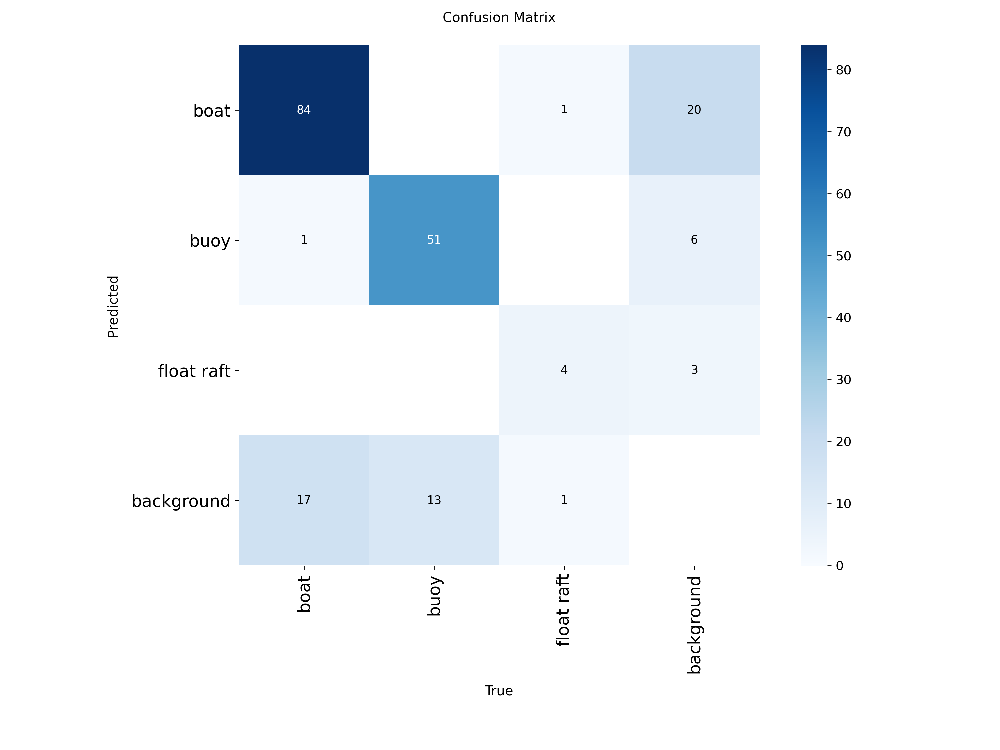

In [ ]:
Image("/content/runs/detect/train/confusion_matrix.png", width=600)

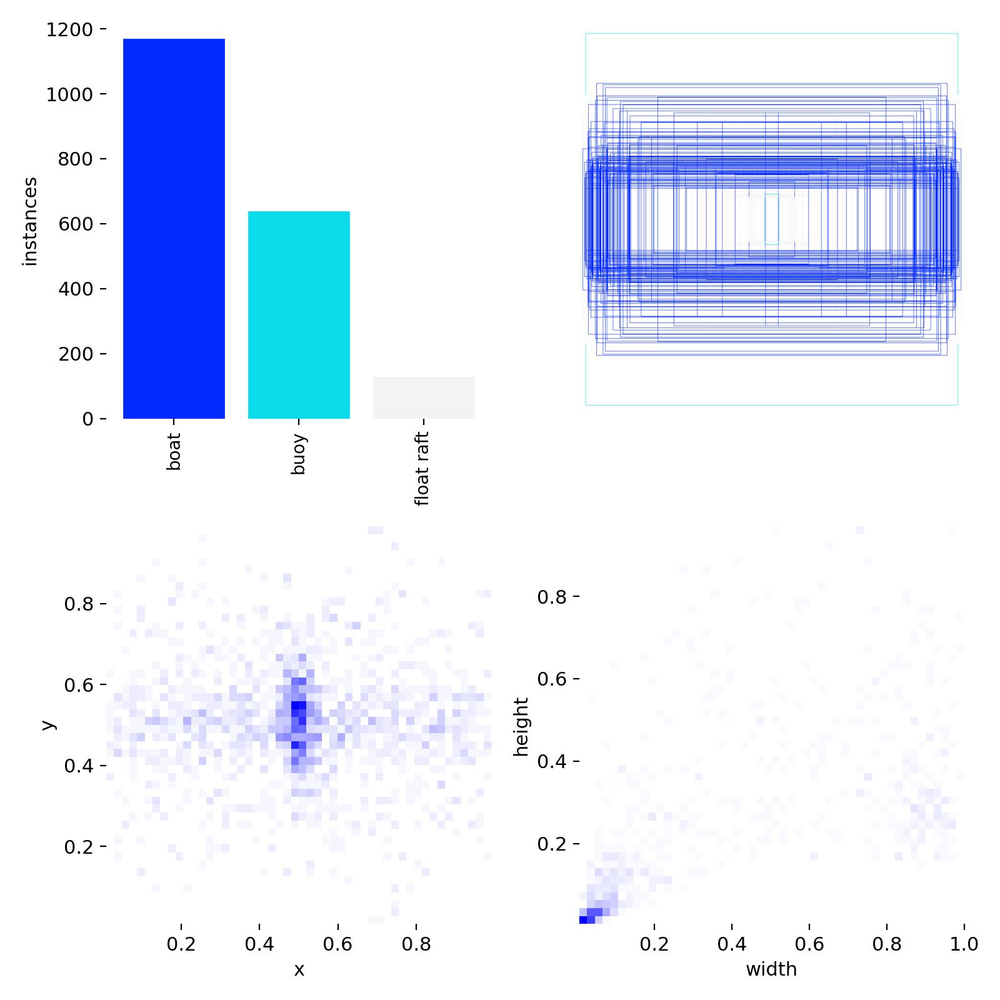

In [ ]:
Image("/content/runs/detect/train/labels.jpg", width=600)

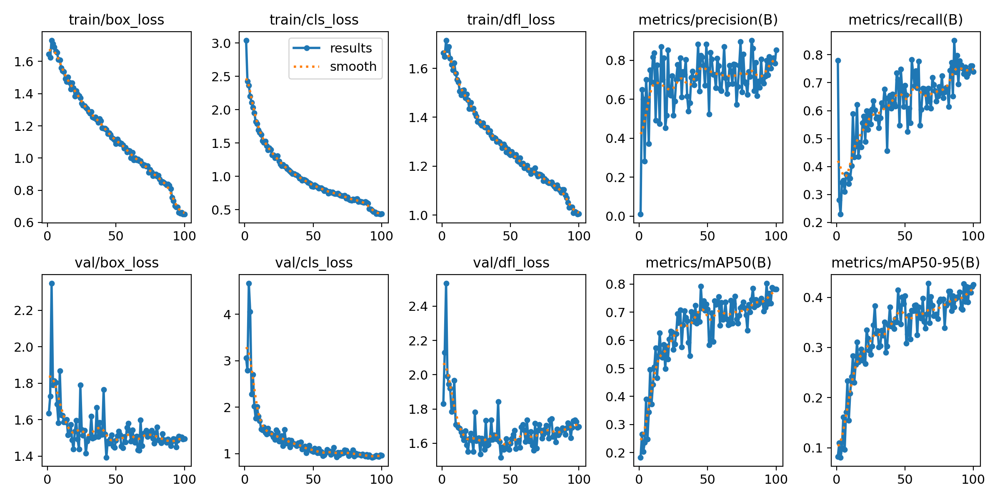

In [ ]:
Image("/content/runs/detect/train/results.png", width=600)

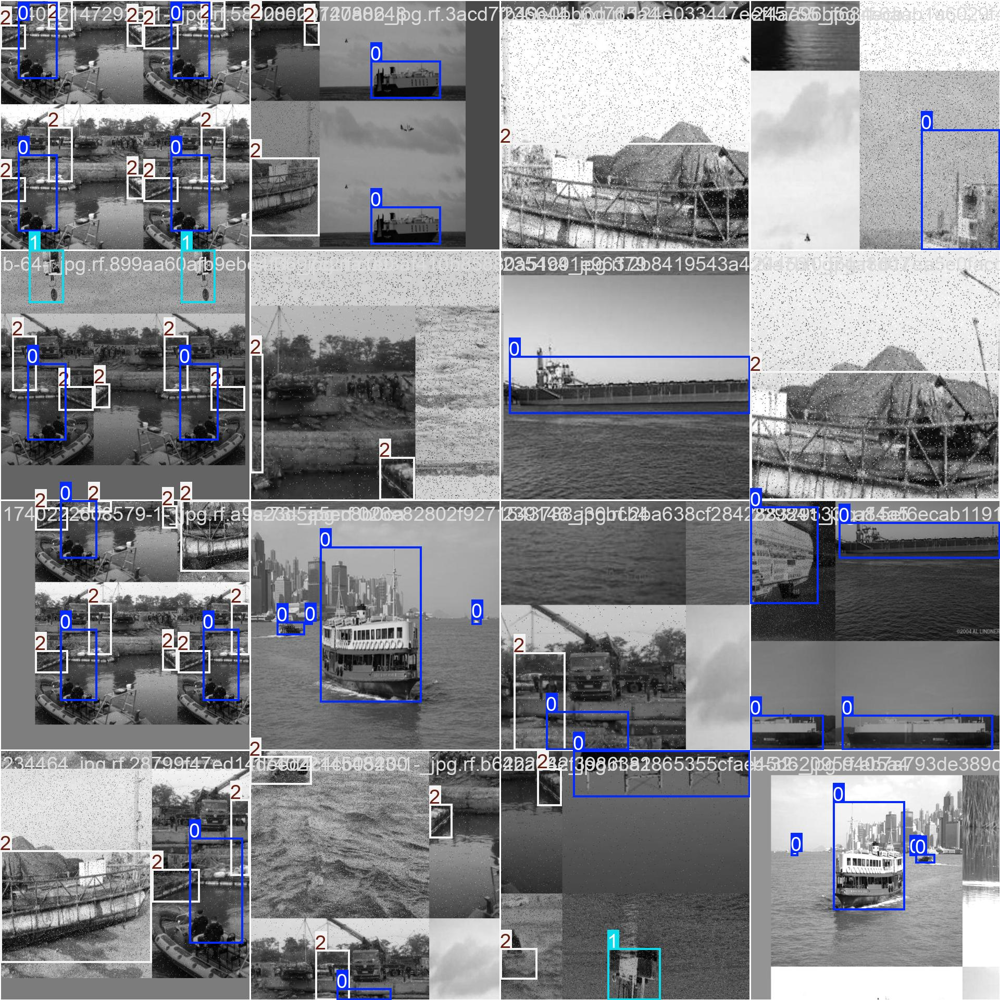

In [ ]:
Image("/content/runs/detect/train/train_batch0.jpg", width=600)

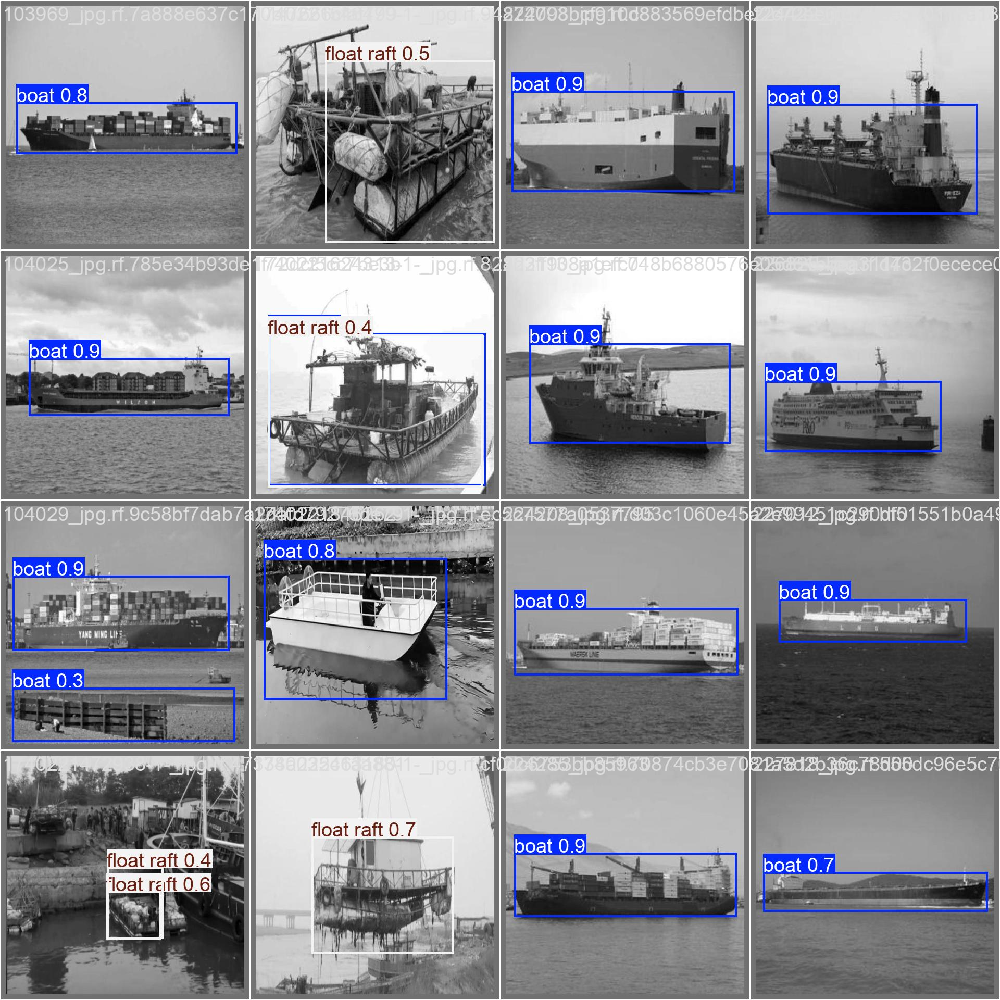

In [ ]:
Image("/content/runs/detect/train/val_batch0_pred.jpg", width=600)

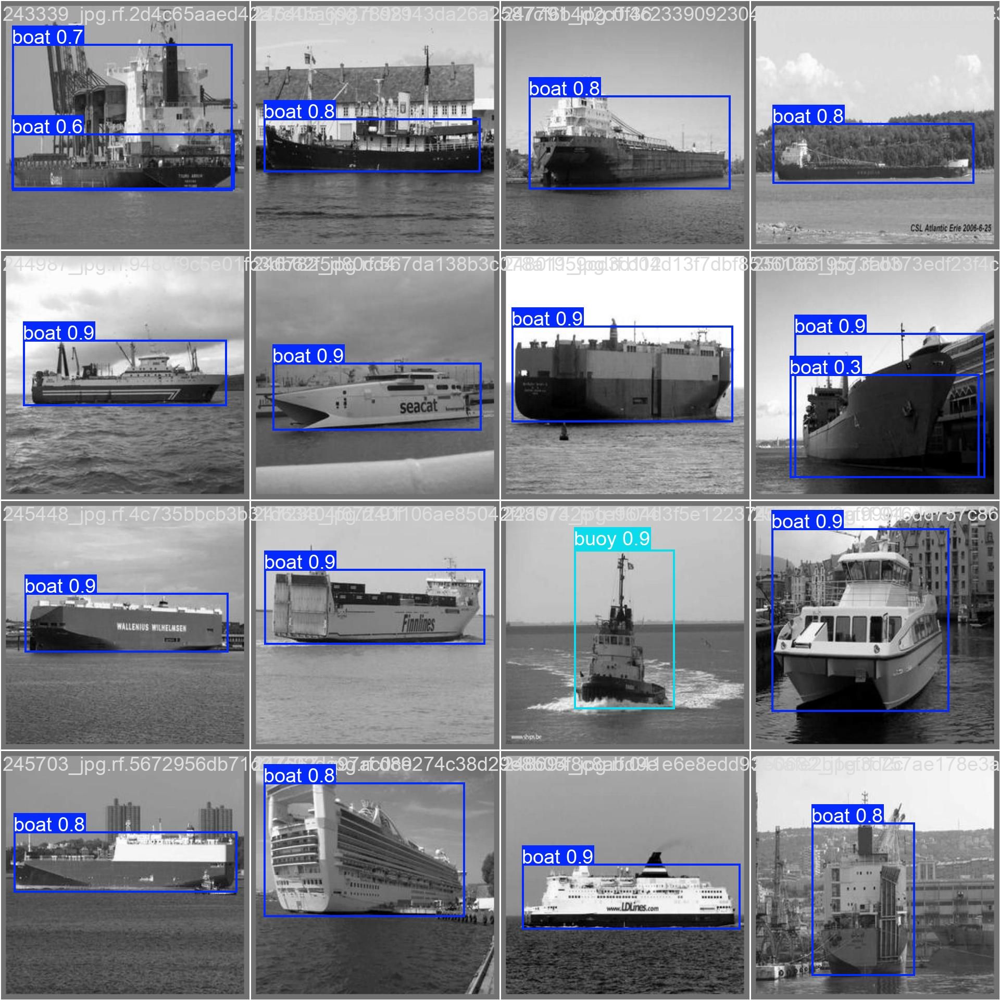

In [ ]:
Image("/content/runs/detect/train/val_batch1_pred.jpg", width=600)

**Step # 08 Inference with Custom Model on Images**

In [ ]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs

image 1/67 /content/ship-or-float-5/test/images/103954_jpg.rf.46483cf4bfe6939f541ef7e672494bc2.jpg: 640x640 1 boat, 12.6ms
image 2/67 /content/ship-or-float-5/test/images/12981175-2675577696_jpg.rf.dbddcee329e4534d9dfcb875b14e73e6.jpg: 640x640 1 boat, 9.9ms
image 3/67 /content/ship-or-float-5/test/images/1740221454855-1-_jpg.rf.a0a23f71500c28db11314c287facf847.jpg: 640x640 1 buoy, 9.2ms
image 4/67 /content/ship-or-float-5/test/images/1740221587591-1-_jpg.rf.853a6f81a693b87d40d1361d5096b726.jpg: 640x640 3 boats, 1 float raft, 8.9ms
image 5/67 /content/ship-or-float-5/test/images/1740222526483-1-_jpg.rf.0f9ed52eadfd2c7b6ea2cd9f8267844f.jpg: 640x640 1 boat, 1 buoy, 10.1ms
image 6/67 /content/ship-or-float-5/test/images/223038_jpg.rf.105a2e2da38efda8b83667dd3418af12.jpg: 640x640 1 boat, 8.4ms
image 7/67 /content/ship-or-float

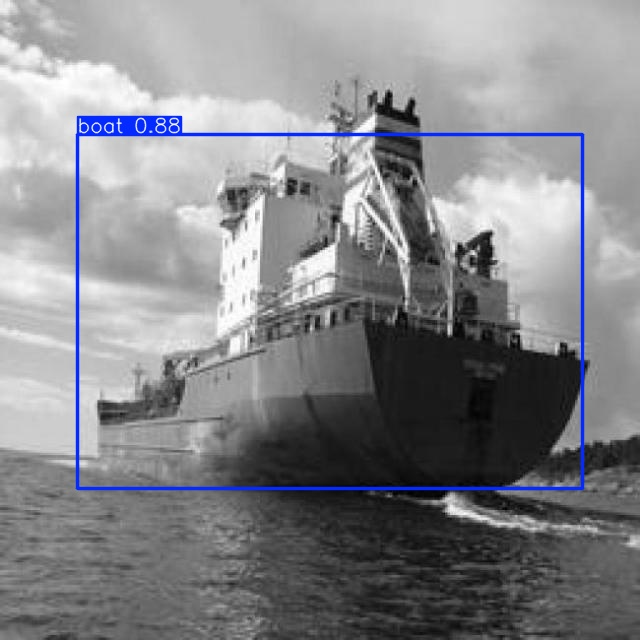

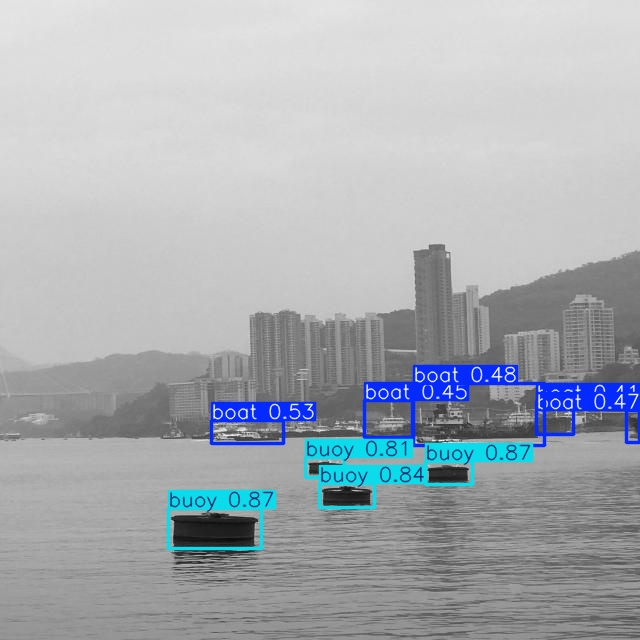

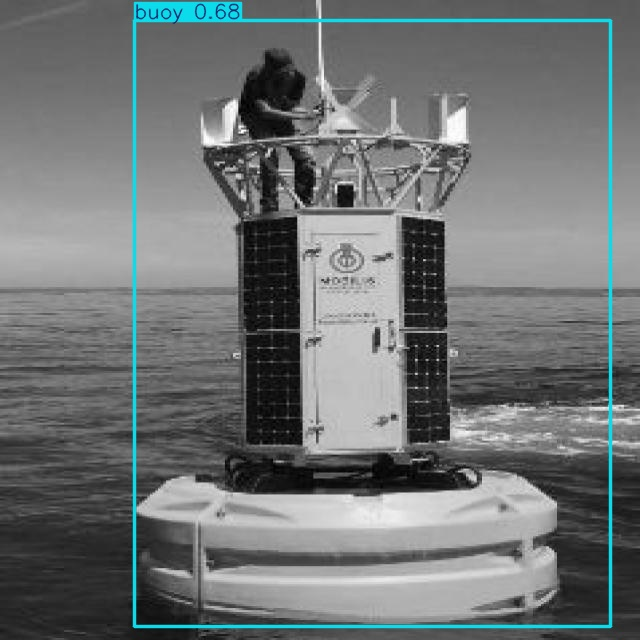

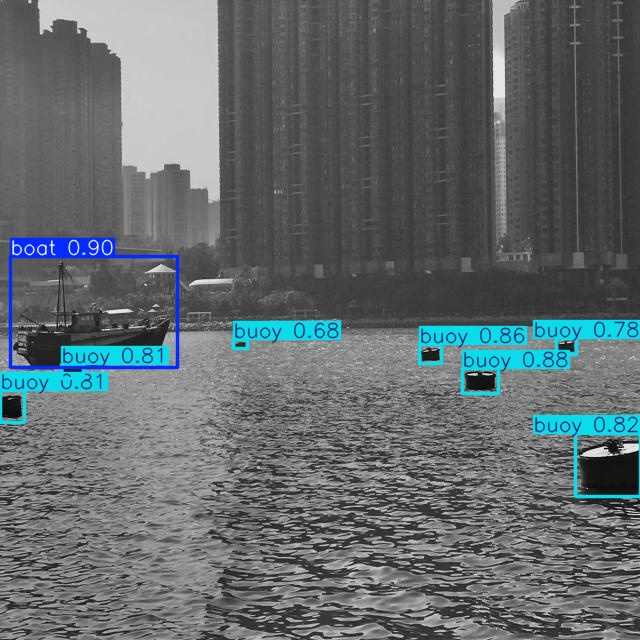

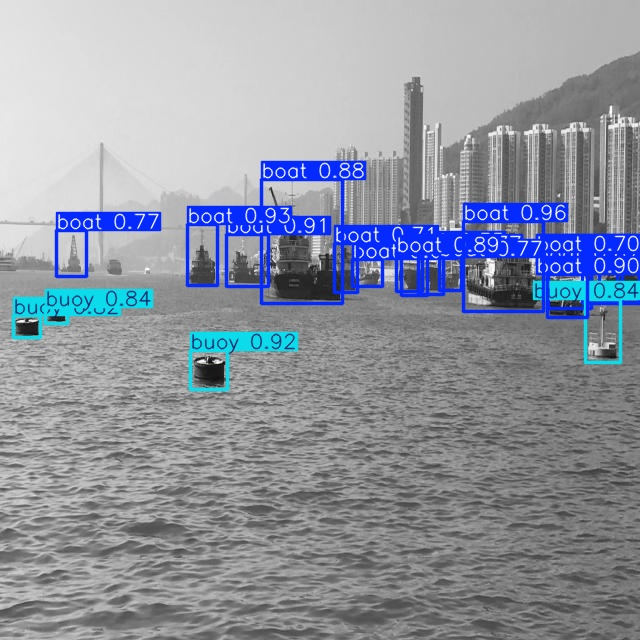

...

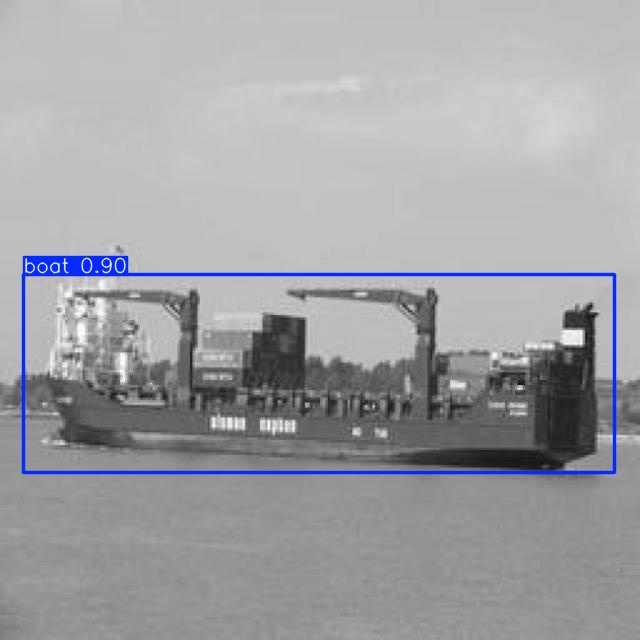

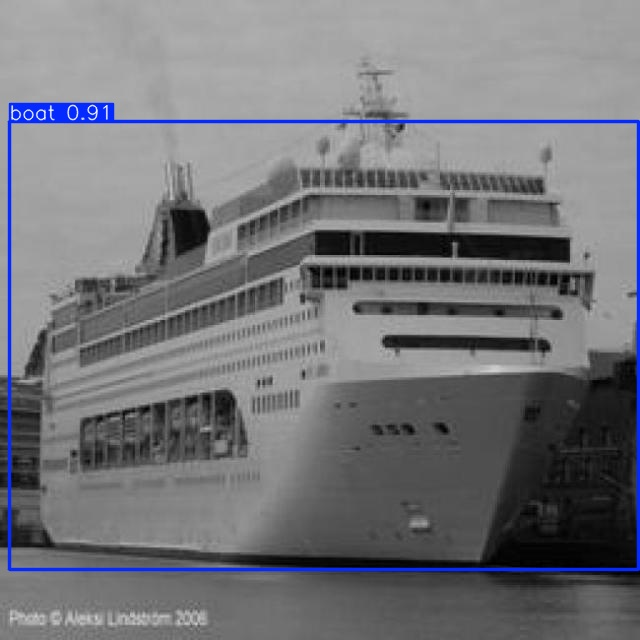

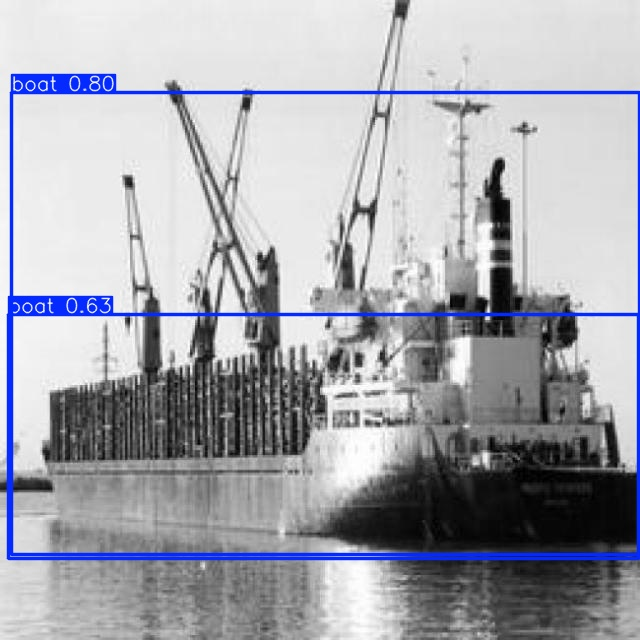

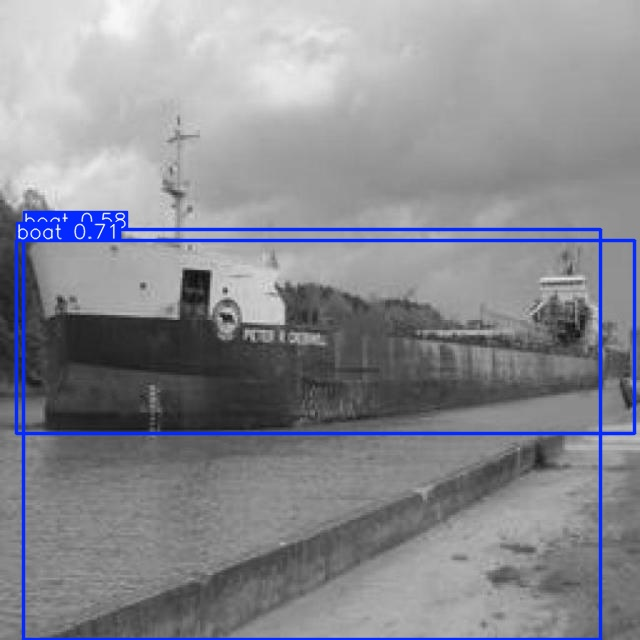

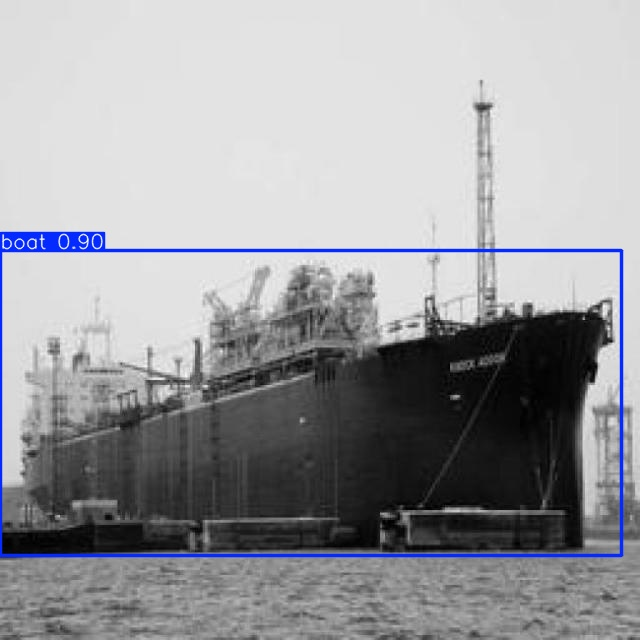

In [ ]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:65]:
    display(IPyImage(filename=img, width=600))
    print("\n")

In [ ]:
!yolo task=detect mode=predict model= "/content/runs/detect/train/weights/best.pt" conf=0.25 source=freighters.jpg save=True

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs

image 1/1 /content/freighters.jpg: 448x640 2 boats, 43.3ms
Speed: 3.6ms preprocess, 43.3ms inference, 144.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


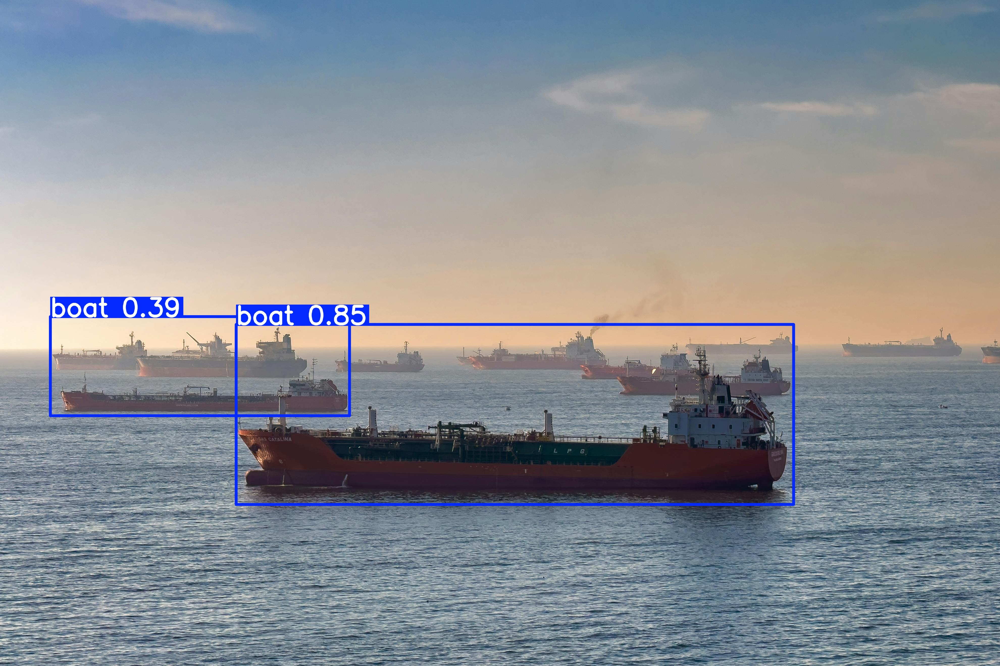

shot by İrfan Simsar on pexels


In [ ]:
display(Image("/content/runs/detect/predict2/freighters.jpg", width=600))


print("shot by İrfan Simsar on pexels")

In [ ]:
!yolo task=detect mode=predict model= "/content/runs/detect/train/weights/best.pt" conf=0.25 source=boat_and_buoy.jpg save=True

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs

image 1/1 /content/boat_and_buoy.jpg: 640x448 2 boats, 1 buoy, 45.0ms
Speed: 3.8ms preprocess, 45.0ms inference, 150.8ms postprocess per image at shape (1, 3, 640, 448)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


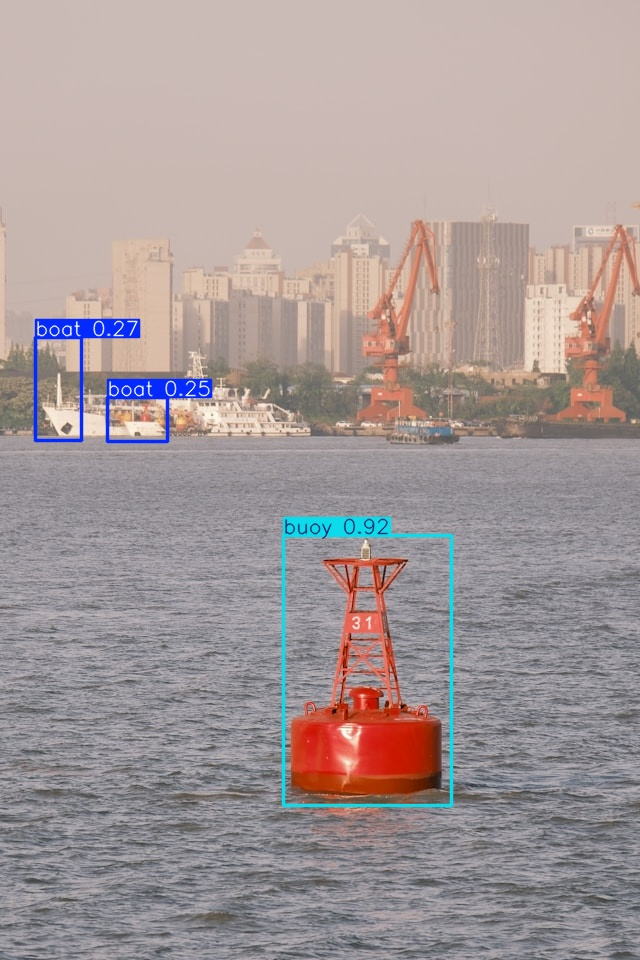

Shot by Nathan Q on unsplash


In [ ]:
display(Image("/content/runs/detect/predict3/boat_and_buoy.jpg", width=600))

print("Shot by Nathan Q on unsplash")

In [ ]:
!yolo task=detect mode=predict model= "/content/runs/detect/train/weights/best.pt" conf=0.25 source=buoys_2.jpg save=True

Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs

image 1/1 /content/buoys_2.jpg: 448x640 6 boats, 9 buoys, 43.3ms
Speed: 4.7ms preprocess, 43.3ms inference, 150.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.ultralytics.com/modes/predict


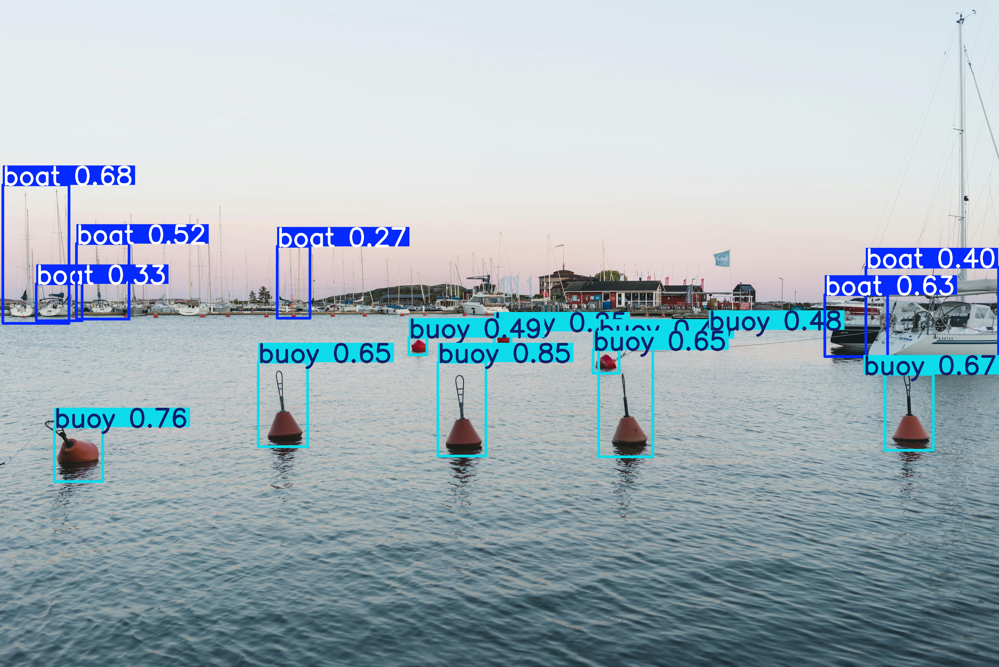

Shot by Matt Hardy on pexels


In [ ]:
display(Image("/content/runs/detect/predict5/buoys_2.jpg", width=600))

print("Shot by Matt Hardy on pexels")

In [ ]:
!yolo task=detect mode=predict model= "/content/runs/detect/train/weights/best.pt" conf=0.25 source="boats_video.mp4" save=True


Ultralytics 8.3.173 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/750) /content/boats_video.mp4: 384x640 1 boat, 48.9ms
video 1/1 (frame 2/750) /content/boats_video.mp4: 384x640 1 boat, 12.5ms
video 1/1 (frame 3/750) /content/boats_video.mp4: 384x640 1 boat, 13.4ms
video 1/1 (frame 4/750) /content/boats_video.mp4: 384x640 1 boat, 13.8ms
video 1/1 (frame 5/750) /content/boats_video.mp4: 384x640 1 boat, 13.2ms
video 1/1 (frame 6/750) /content/boats_video.mp4: 384x640 1 boat, 11.1ms
video 1/1 (frame 7/750) /content/boats_video.mp4: 384x640 1 boat, 14.6ms
video 1/1 (frame 8/750) /content/boats_video.mp4: 384x640 1 boat, 13.7ms
video 1/1 (frame 9/750) /content/boats_video.mp4: 384x640 1 boat, 12.8ms
video 1/1 (frame 10/750) /content/boats_video.mp4: 384x640 1 boat, 11.2ms
video 1/1 (frame 11/750) /content/boats_video.mp4: 384x640 1 boat, 21.9ms
video 1/1 (frame 12/750) /co

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict6/boats_video.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=600 controls>
    <source src="%s" type="video/mp4">
</video>
""" % data_url)